# Calculating hydrogen bonds: the basics

We will find the hydrogen bonds in a box of water in order to demonstrate the basic usage of HydrogenBondAnaysis.

**Last updated:** February 3, 2021 with MDAnalysis 2.0.0-dev

**Minimum version of MDAnalysis:** 2.0.0-dev0

**Packages required:**
    
* MDAnalysis (<a data-cite="michaud-agrawal_mdanalysis_2011" href="https://doi.org/10.1002/jcc.21787">Michaud-Agrawal *et al.*, 2011</a>, <a data-cite="gowers_mdanalysis_2016" href="https://doi.org/10.25080/Majora-629e541a-00e">Gowers *et al.*, 2016</a>)
* MDAnalysisTests
* [numpy](https://numpy.org)
* [matplotlib](https://matplotlib.org)

**See also**

* [Calculating hydrogen bonds: advanced selections](hbonds-selections.ipynb)
* [Calculating hydrogen bond lifetimes](hbonds-lifetime.ipynb)

<div class="alert alert-info">
    
**Note**

Please cite [Smith et al. (2018)](http://dx.doi.org/10.1039/C9CP01532A) when using HydrogenBondAnaysis in published work.

</div>

In [1]:
import pickle
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

import MDAnalysis as mda
from MDAnalysis.tests.datafiles import waterPSF, waterDCD
from MDAnalysis.analysis.hydrogenbonds import HydrogenBondAnalysis

# the next line is necessary to display plots in Jupyter
%matplotlib inline


## Loading files

We will load a small water-only systems containing 5 water molecules and 10 frames then find the hydrogen bonds present at each frame.

In [2]:
u = mda.Universe(waterPSF, waterDCD)

<div class="alert alert-warning">
    
**Warning**

It is **highly recommended** that a topology with bond information is used (e.g. PSF, TPR, PRMTOP), as this is the only way to guarantee the correct identification of donor-hydrogen pairs.

</div>

## Hydrogen bonds


In molecular dynamics simulations, hydrogen bonds are typically identified via the following geometric criteria:

1. the donor-acceptor distance ($r_{DA}$) must be less than a specified cutoff, typically 3 Å
2. the donor-hydrogen-acceptor angle ($\theta_{DHA}$) must be greater than a specified cutoff, typically 150°

<div>
<center>    
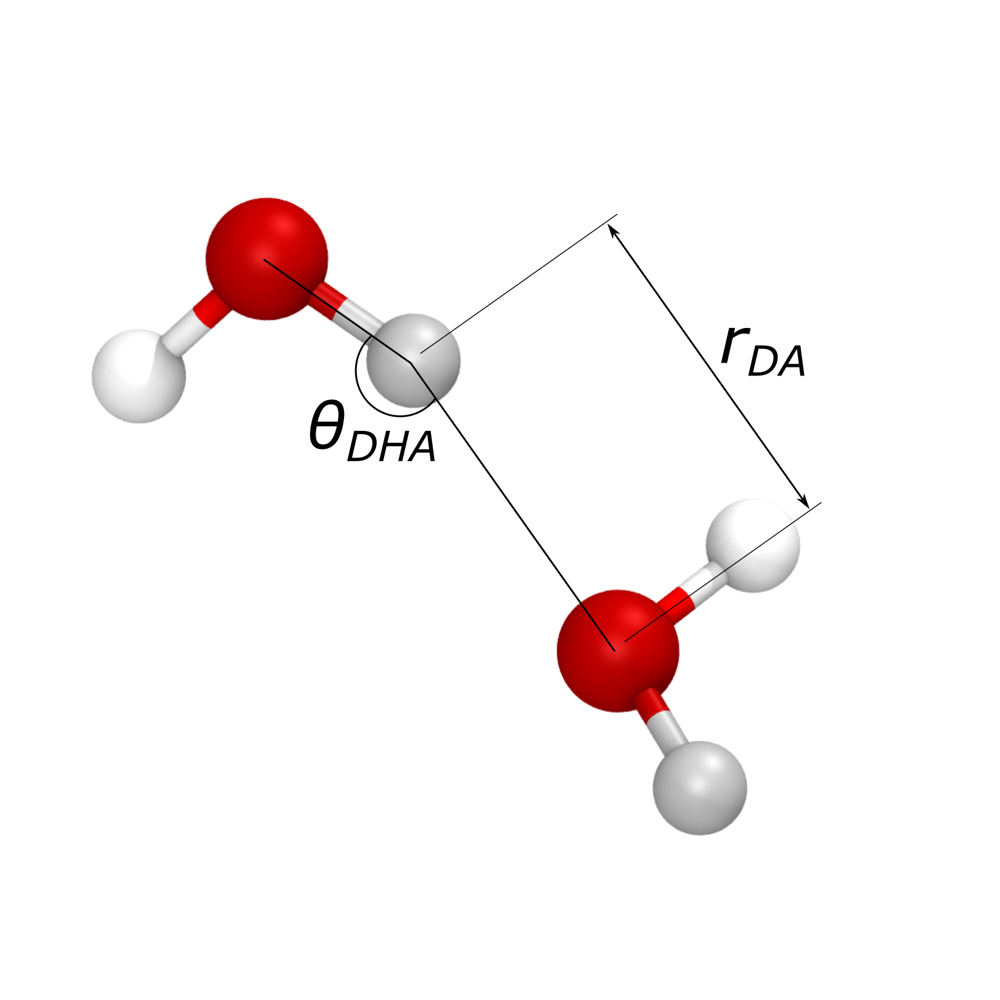
</center>
</div>

## Find water-water hydrogen bonds

Basic usage of HydrogenBondAnalysis involvees passing an acceptor atom selection (`acceptors_sel`) and a hydrogen atom selection (`hydrogens_sel`) to `HydrogenBondAnalysis`. By not providing a donor atom selection (`donor_sel`) we will use the topology bond information to find donor-hydrogen pairs.

In [3]:
hbonds = HydrogenBondAnalysis(
    universe=u,
    donors_sel=None,
    hydrogens_sel="name H1 H2",
    acceptors_sel="name OH2",
    d_a_cutoff=3.0,
    d_h_a_angle_cutoff=150,
    update_selections=False
)


<div class="alert alert-info">
    
**Note**
    
For a small performance boost, `update_selections` can always be set to `False` unless the given selections will result in an `AtomGroup` that changes across frames, e.g if `acceptors_sel="name OH2 and around 3.0 protein"` then `update_selections` must be `True`
    
</div>

If we do not set the `start`, `stop`, and `step` for frames to analyse, all frames will be used.

In [4]:
hbonds.run(
    start=None,
    stop=None,
    step=None,
    verbose=True
)


  0%|          | 0/10 [00:00<?, ?it/s]

The results are stored as a numpy array in the `hbonds.hbonds` attribute

Each row of the results array contains information on a single hydrogen bond

`[frame, donor_index, hydrogen_index, acceptor_index, DA_distance, DHA_angle]`

For clarity, below we define constants that will be used to access the relevant column of each hbond row


In [5]:
FRAME = 0
DONOR = 1
HYDROGEN = 2
ACCEPTOR = 3
DISTANCE = 4
ANGLE = 5


## Helper functions
The are three helper functions that can be used to quickly post-process the results.

**1. Count by time.** Counts the total number of hydrogen bonds at each frame

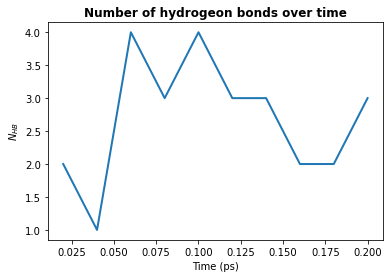

In [6]:
plt.plot(hbonds.times, hbonds.count_by_time(), lw=2)

plt.title("Number of hydrogeon bonds over time", weight="bold")
plt.xlabel("Time (ps)")
plt.ylabel(r"$N_{HB}$")

plt.show()


**2. Count by type.** Counts the total number of each type of hydrogen bond.<br>

A type is a unique combination of donor residue name, donor atom type, acceptor residue name, and acceptor atom type.


In [7]:
hbonds.count_by_type()

array([['TIP3:OT', 'TIP3:OT', '27']], dtype='<U7')


Each row contains a unique hydrogen bond type.<br>
The three columns correspond to:<br>

   1. the donor resname and donor name
   2. the acceptor resname and acceptor name
   3. the total count
   

The average number of each type of hydrogen bond formed at each frame is likely more informative than the total number over the trajectory. This can be calculated for each hydrogen bond type as follows:

In [8]:
n_frames = hbonds.frames.size
for donor, acceptor, count in hbonds.count_by_type():
    
    donor_resname, donor_type = donor.split(":")
    n_donors = u.select_atoms(f"resname {donor_resname} and type {donor_type}").n_atoms
    
    # average number of hbonds per donor molecule per frame
    mean_count = int(count) / (n_frames * n_donors)
    print(f"{donor} to {acceptor}: {mean_count:.2f}")


TIP3:OT to TIP3:OT: 0.54


<div class="alert alert-info">
    
**Note**
    
In a water-only system the average number of hyrogen bonds per water molecule should be around 3.3, depending on temperature and forcefield. We don't see this due to the small system size (15 water molecules).

</div>

**3. Count by ids.** Counts the total number of each hydrogen bond formed between specific atoms.<br>




In [9]:
hbonds.count_by_ids()

array([[12, 14,  9, 10],
       [ 9, 10,  3,  9],
       [ 3,  5,  0,  4],
       [ 0,  1,  6,  3],
       [ 6,  7, 12,  1]])

Each row contains a unique hydrogen bond.<br>
The four columns correspond to:<br>

   1. the donor atom index
   2. the hydrogen atom index
   2. the acceptor atom index
   3. the total count
   
The array is sorted in descending total count. You can check which atoms are involved in the most frequently observed hydrogen bond:


In [10]:
counts = hbonds.count_by_ids()
most_common = counts[0]

u.atoms[most_common[DONOR]], u.atoms[most_common[HYDROGEN]], u.atoms[most_common[ACCEPTOR]]


(<Atom 15: H2 of type HT of resname TIP3, resid 21 and segid WAT>,
 <Atom 10: OH2 of type OT of resname TIP3, resid 15 and segid WAT>,
 <Atom 11: H1 of type HT of resname TIP3, resid 15 and segid WAT>)

## Further analysis

There are many different analyses you may want to perform after finding hydrogen bonds. Below we will calculate the mean number of hydrogen bonds as a function of $z$ position of the donor atom.


In [11]:
# bins in z for the histogram
bin_edges = np.linspace(-25, 25, 51)
bin_centers = bin_edges[:-1] + 0.5

# results array
counts = np.full(bin_centers.size, fill_value=0.0)

for ts in u.trajectory[hbonds.frames]:
    
    donors = u.atoms[hbonds.hbonds[hbonds.hbonds[:, FRAME] == ts.frame, DONOR].astype(int)]
    zpos = donors.positions[:,2]
    hist, *_ = np.histogram(zpos, bins=bin_edges)
    counts += hist

counts /= hbonds.frames.size   


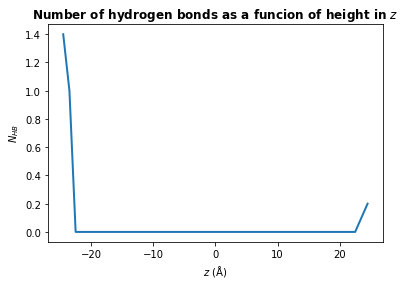

In [12]:
plt.plot(bin_centers, counts, lw=2)

plt.title(r"Number of hydrogen bonds as a funcion of height in $z$", weight="bold")
plt.xlabel(r"$z\ \rm (\AA)$")
plt.ylabel(r"$N_{HB}$")

plt.show()


You may wish to find the number of hydrogen bonds in $z$ per unit area in $xy$, rather than the total number a each $z$ position. To do this, simply divide `counts` by the mean area in $xy$:

In [ ]:
mean_xy_area = np.mean([np.product(ts.dimensions[:2]) for ts in u.trajectory[hbonds.frames]])
counts /= mean_xy_area


<div class="alert alert-info">
    
**Note**
    
It is likely you will want to calculate the distance from an interface, such as a lipid membrane, rather than the absolute position in $z$. In this case:
    
    zpos = donors.positions[:,2] - interface_zpos
    
</div>

## Store data
There are various ways of storing the results from the analysis.

1. You can persist the HydrogenBondsAnalysis object using pickle (or joblib)

In [13]:
with open("data/hbonds.pkl", 'wb') as f:
    pickle.dump(hbonds, f)
    

In [14]:
with open("data/hbonds.pkl", 'rb') as f:
    hbonds = pickle.load(f)
    

2. You can extract the results and store the numpy array

In [15]:
np.save("data/hbonds.npy", hbonds.hbonds)

3. You can create a Pandas DataFrame with more information about hydrogen bonding atoms, which may make some further analysis easier.

In [16]:
frame, donor_indices, hydrogen_indices, acceptor_indices = hbonds.hbonds[:, :DISTANCE].T.astype(int)
distances, angles = hbonds.hbonds[:, DISTANCE:].T

df = pd.DataFrame(
    
    data = np.array([
        frame,
        donor_indices,
        hydrogen_indices,
        acceptor_indices,
        u.atoms[donor_indices].resnames,
        u.atoms[donor_indices].resids,
        u.atoms[donor_indices].names,
        u.atoms[hydrogen_indices].names,
        u.atoms[acceptor_indices].resnames,
        u.atoms[acceptor_indices].resids,
        u.atoms[acceptor_indices].names,
        distances,
        angles
    ]).T,
    
    columns=[
        "Frame",
        "Donor_ix",
        "Hydrogen_ix",
        "Acceptor_ix",
        "Donor_resname",
        "Donor_resid",
        "Donor_name",
        "Hydrogen_name",
        "Acceptor_resname",
        "Accetpor_resid",
        "Accetpor_name",
        "Distance",
        "Angle"
    ]
    
)


In [17]:
df.to_csv("data/hbonds.csv", index=False)

## References

[1] Richard&nbsp;J. Gowers, Max Linke, Jonathan Barnoud, Tyler J.&nbsp;E. Reddy, Manuel&nbsp;N. Melo, Sean&nbsp;L. Seyler, Jan Domański, David&nbsp;L. Dotson, Sébastien Buchoux, Ian&nbsp;M. Kenney, and Oliver Beckstein.
<span class="bibtex-protected">MDAnalysis</span>: <span class="bibtex-protected">A</span> <span class="bibtex-protected">Python</span> <span class="bibtex-protected">Package</span> for the <span class="bibtex-protected">Rapid</span> <span class="bibtex-protected">Analysis</span> of <span class="bibtex-protected">Molecular</span> <span class="bibtex-protected">Dynamics</span> <span class="bibtex-protected">Simulations</span>.
<em>Proceedings of the 15th Python in Science Conference</em>, pages 98–105, 2016.
00152.
URL: <a href="https://conference.scipy.org/proceedings/scipy2016/oliver_beckstein.html">https://conference.scipy.org/proceedings/scipy2016/oliver_beckstein.html</a>, <a href="https://doi.org/10.25080/Majora-629e541a-00e">doi:10.25080/Majora-629e541a-00e</a>.

[2] Naveen Michaud-Agrawal, Elizabeth&nbsp;J. Denning, Thomas&nbsp;B. Woolf, and Oliver Beckstein.
<span class="bibtex-protected">MDAnalysis</span>: <span class="bibtex-protected">A</span> toolkit for the analysis of molecular dynamics simulations.
<em>Journal of Computational Chemistry</em>, 32(10):2319–2327, July 2011.
00778.
URL: <a href="http://doi.wiley.com/10.1002/jcc.21787">http://doi.wiley.com/10.1002/jcc.21787</a>, <a href="https://doi.org/10.1002/jcc.21787">doi:10.1002/jcc.21787</a>.

[3] Paul Smith, Robert&nbsp;M. Ziolek, Elena Gazzarrini, Dylan&nbsp;M. Owen, and Christian&nbsp;D. Lorenz.
On the interaction of hyaluronic acid with synovial fluid lipid membranes.
<em>Phys. Chem. Chem. Phys.</em>, 21(19):9845-9857, 2018.
URL: <a href="http://dx.doi.org/10.1039/C9CP01532A">http://dx.doi.org/10.1039/C9CP01532A

